In [164]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from sklearn import preprocessing
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn import metrics
from sklearn.tree import DecisionTreeRegressor, plot_tree
import os
from io import StringIO
from subprocess import check_call
from IPython.display import Image as PImage
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from IPython.display import display

#Preparación

Importo dataset de github

In [165]:
url1 = "https://raw.githubusercontent.com/pasa97/TP1/main/California_Housing_CitiesAdded.csv"
California_raw = pd.read_csv(url1)
df = California_raw.copy()

Miro 10 filas al azar

In [166]:
df.sample(10)

,Median_House_Value,Median_Income,Median_Age,Tot_Rooms,Tot_Bedrooms,Population,Households,Latitude,Longitude,Distance_to_coast,Distance_to_LA,Distance_to_SanDiego,Distance_to_SanJose,Distance_to_SanFrancisco,ocean_proximity,City
9112,194100.0,6.0296,7,2045,342,878,292,34.50,-117.27,114229.88890,102386.32470,198657.2709,522113.665300,589200.24300,INLAND,San Bernardino
12750,153300.0,3.2500,39,552,151,807,168,33.99,-118.07,27931.28227,17438.79589,164932.4206,507513.208900,575548.30000,<1H OCEAN,Los Angeles
11962,161400.0,5.2460,11,10804,1493,5221,1482,34.14,-117.38,76794.66145,80124.49906,159668.4578,540400.750100,608084.30700,INLAND,San Bernardino
19,500001.0,11.7064,17,1320,159,1722,141,37.84,-122.08,17330.10107,544544.61680,723647.3133,58469.029870,31723.73054,NEAR BAY,Contra Costa
10702,175000.0,3.2872,17,2033,452,1114,446,38.01,-121.34,17016.84664,520682.76620,699915.6605,89411.903840,99293.75183,INLAND,San Joaquin
4052,292300.0,6.0194,44,3424,597,1358,597,37.84,-122.21,9357.78709,552031.48350,730972.5239,62667.799810,20781.71483,NEAR BAY,Alameda
1959,384600.0,5.9300,20,1151,211,478,183,38.41,-122.56,32878.97612,620056.70880,799276.6499,133051.728100,71614.31414,<1H OCEAN,Sonoma
8673,201200.0,3.1830,14,1665,390,505,348,38.44,-122.59,37037.78982,624292.14920,803513.3989,137203.178900,75349.39913,<1H OCEAN,Sonoma
18775,79000.0,3.0862,45,907,188,479,161,37.94,-122.36,2145.82404,569087.76230,747974.3559,78798.279990,19493.74280,NEAR BAY,Contra Costa
1504,424600.0,7.8575,26,1797,244,626,244,37.29,-121.90,25791.62482,488484.60100,666884.9617,5094.594968,71350.48263,<1H OCEAN,Santa Clara


In [167]:
df.columns

Index(['Median_House_Value', 'Median_Income', 'Median_Age', 'Tot_Rooms',
       'Tot_Bedrooms', 'Population', 'Households', 'Latitude', 'Longitude',
       'Distance_to_coast', 'Distance_to_LA', 'Distance_to_SanDiego',
       'Distance_to_SanJose', 'Distance_to_SanFrancisco', 'ocean_proximity',
       'City'],
      dtype='object')

In [168]:
df.columns = ['MediaPrecioHogar', 'MediaIngresos','MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion','Familias','Latitud', 'Longitud',
       'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'CercaniaOceano',
       'Ciudad']
df.head(3)

,MediaPrecioHogar,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,CercaniaOceano,Ciudad
0,500001.0,1.2434,52,249,78,396,85,37.80,-122.27,2524.614616,552234.0515,731023.5749,61415.35211,14466.70538,NEAR BAY,Alameda
1,500001.0,1.1696,52,609,236,1349,250,37.87,-122.25,7897.024567,556856.9280,735788.3723,67242.51828,19172.81885,NEAR BAY,Alameda
2,500001.0,7.8521,52,1668,225,517,214,37.86,-122.24,9154.528309,555442.5086,734372.6023,65849.13943,19335.74118,NEAR BAY,Alameda


MediaIngresos: Refiere a la media de los ingresos de las familias que viven en esa manzana. Medido en dolares

MediaEdad: Edad media de una casa en una manzana. Más alto = Más viejo

Ambientes: Media de habitaciones en una manzana

Dormitorios: Media de habitaciones destinadas a dormir en una manzana

Poblacion: Gente viviendo en una manzana

Familias: Cantidad de familias o grupos de personas que viven en esa manzana

DistCosta: Distancia al oceano en metros

Dist Ciudades: Distancia a la ciudad mencionada en metros.

CercaniaOceano: Indica que tan cerca se encuentra la manzana de la costa categoricamente.

Ciudad: La ciudad en la que se encuentra.

Latitud y Longitud: Coordenadas geográficas de la manzana

Lo abro con geopandas ahora para trabajar directo con esto ya que tiene columnas de longitud y latitud

In [169]:
geometry = gpd.points_from_xy(df.Longitud, df.Latitud)

In [170]:
gdf = gpd.GeoDataFrame(df, geometry=geometry)

In [171]:
gdf.sample(4)

,MediaPrecioHogar,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,CercaniaOceano,Ciudad,geometry
1473,427600.0,3.7463,30,2956,590,1191,594,37.49,-122.24,6653.886816,525355.264300,703526.0472,35132.59781,35788.78027,NEAR OCEAN,San Mateo,POINT (-122.24 37.49)
1708,404800.0,5.6511,15,5132,1059,2156,982,37.32,-122.03,17958.997240,498871.376100,677058.9082,12232.76959,61642.62258,<1H OCEAN,Santa Clara,POINT (-122.03 37.32)
11508,165100.0,1.9219,52,1081,311,904,283,34.12,-118.18,32140.368900,9548.410429,182547.8805,489987.22320,558022.00630,<1H OCEAN,Los Angeles,POINT (-118.18 34.12)
15258,122800.0,3.2083,43,1970,379,1036,391,34.07,-117.64,56115.928060,55645.299950,157013.1985,528395.57420,596297.67500,INLAND,San Bernardino,POINT (-117.64 34.07)


La nueva columna "geometry" representa con puntos a cada manzana en base a las columnas Latitud y Longitud

Revisamos que tipo de variables tengo. Se intentará predecir el precio de la vivienda en base a los datos de las demás columnas para luego, al construir o intentar vender un terreno o edificio en una manzana no registrada en el censo, poder estimar un precio en base a nuestro dataset.


Las más importantes, como hipótesis, parecerían ser

    Latitud y Longitud o bien Distancia al oceano

    Ciudad

    Cantidad de habitaciones



In [172]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   MediaPrecioHogar  20640 non-null  float64 
 1   MediaIngresos     20640 non-null  float64 
 2   MediaEdad         20640 non-null  int64   
 3   Ambientes         20640 non-null  int64   
 4   Dormitorios       20640 non-null  int64   
 5   Poblacion         20640 non-null  int64   
 6   Familias          20640 non-null  int64   
 7   Latitud           20640 non-null  float64 
 8   Longitud          20640 non-null  float64 
 9   DistCosta         20640 non-null  float64 
 10  DistLA            20640 non-null  float64 
 11  DistSanDiego      20640 non-null  float64 
 12  DistSanJose       20640 non-null  float64 
 13  DistSanFran       20640 non-null  float64 
 14  CercaniaOceano    20640 non-null  object  
 15  Ciudad            20640 non-null  object  
 16  geometry      

Se grafica el mapa de California y los puntos de latitud y longitud para confirmar, a simple vista, que estamos hablando de el estado de EEUU.


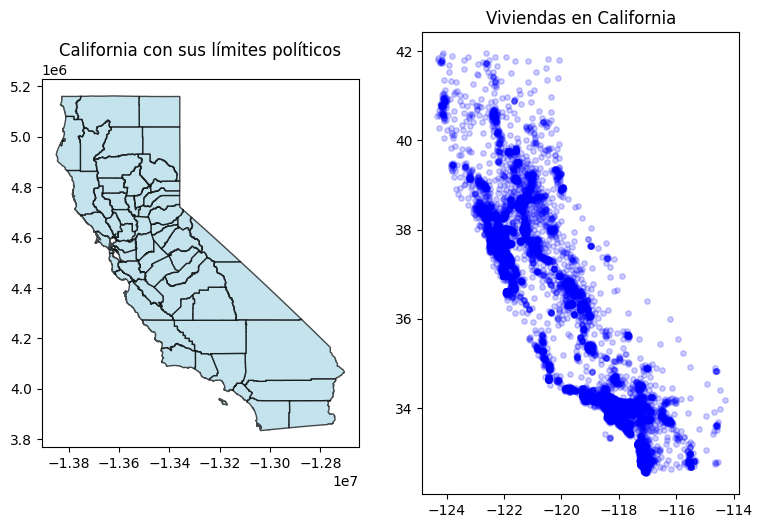

In [173]:
url2 = 'https://raw.githubusercontent.com/pasa97/TP1/main/California_Counties_6472744560795949404.geojson'


gdf2 = gpd.read_file(url2)

polygons = gdf2[gdf2.geometry.type == 'Polygon']
multi_polygons = gdf2[gdf2.geometry.type == 'MultiPolygon']

multi_polygons1 = pd.concat([polygons,multi_polygons])

fig, ax = plt.subplots(1,2,figsize=(9,6))
multi_polygons1.plot(ax=ax[0], color='lightblue', edgecolor='black', alpha=0.7)
ax[0].set_title('California con sus límites políticos')

ax[1].scatter(gdf['Longitud'],gdf['Latitud'], color='blue', s=15, alpha= 0.2)
ax[1].set_title('Viviendas en California')
plt.show()

In [174]:
gdf.columns

Index(['MediaPrecioHogar', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias', 'Latitud', 'Longitud',
       'DistCosta', 'DistLA', 'DistSanDiego', 'DistSanJose', 'DistSanFran',
       'CercaniaOceano', 'Ciudad', 'geometry'],
      dtype='object')

#Entendimiento

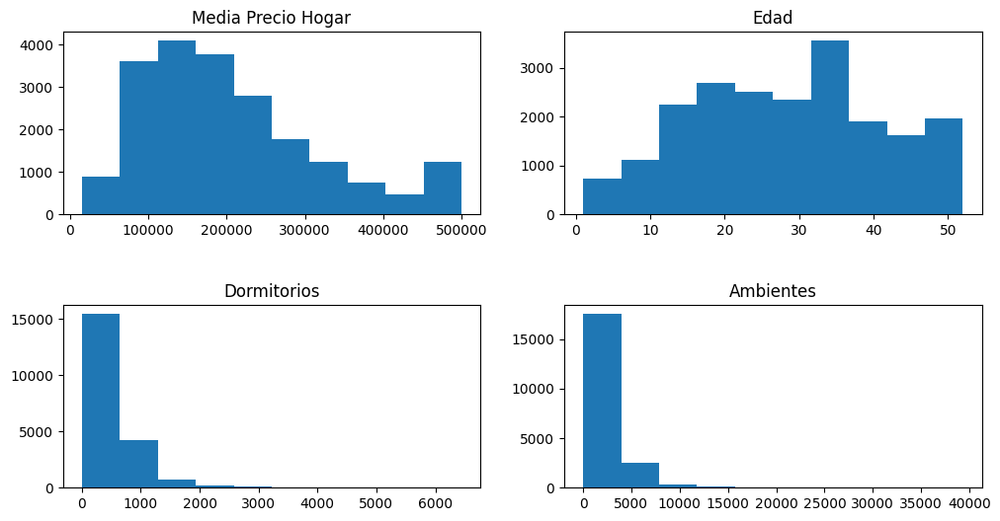

In [175]:
fig, ax = plt.subplots(2,2,figsize=(12,6))
ax[0,0].hist(gdf['MediaPrecioHogar'])
ax[0,0].set_title('Media Precio Hogar')

ax[0,1].hist(gdf['MediaEdad'])
ax[0,1].set_title('Edad')


ax[1,0].hist(gdf['Dormitorios'])
ax[1,0].set_title('Dormitorios')

ax[1,1].hist(gdf['Ambientes'])
ax[1,1].set_title('Ambientes')

fig.subplots_adjust(hspace=0.5)
plt.show()

Se pueden observar muchos outliers en "Dormitorios" y "Ambientes". De todos modos, estos datos podrían ser reales si se tratase de una manzana comprendida de torres.

En "MediaPrecioHogar" se puede observar

In [176]:
print(gdf['MediaPrecioHogar'].describe())
print('\n')
print(gdf['MediaEdad'].describe())

count     20640.000000
mean     206855.816909
std      115395.615874
min       14999.000000
25%      119600.000000
50%      179700.000000
75%      264725.000000
max      500001.000000
Name: MediaPrecioHogar, dtype: float64


count    20640.000000
mean        28.639486
std         12.585558
min          1.000000
25%         18.000000
50%         29.000000
75%         37.000000
max         52.000000
Name: MediaEdad, dtype: float64


Los valores de "MediaPrecioHogar" y "MediaEdad" parecen estar bastante bien distribuidos entre su valor máximo y mínimo.

In [177]:
print(gdf['Dormitorios'].describe())
print('\n')
print(gdf['Ambientes'].describe())

count    20640.000000
mean       537.898014
std        421.247906
min          1.000000
25%        295.000000
50%        435.000000
75%        647.000000
max       6445.000000
Name: Dormitorios, dtype: float64


count    20640.000000
mean      2635.763081
std       2181.615252
min          2.000000
25%       1447.750000
50%       2127.000000
75%       3148.000000
max      39320.000000
Name: Ambientes, dtype: float64


"Dormitorios" y "Ambientes" tienen valores máximos muy lejanos a la media, lo que indicaría, como se mencionó anteriormente, la presencia de outliers.

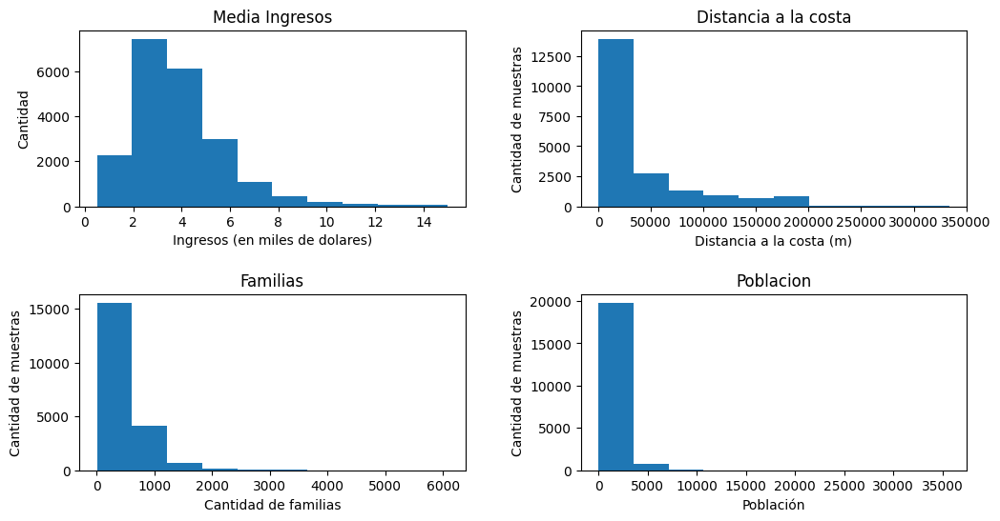

In [178]:


fig, ax = plt.subplots(2,2,figsize=(12,6))

ax[0,0].hist(gdf['MediaIngresos'])
ax[0,0].set_title('Media Ingresos')
ax[0,0].set_ylabel('Cantidad')
ax[0,0].set_xlabel('Ingresos (en miles de dolares)')


ax[0,1].hist(gdf['DistCosta'])
ax[0,1].set_title('Distancia a la costa')
ax[0,1].set_ylabel('Cantidad de muestras')
ax[0,1].set_xlabel('Distancia a la costa (m)')


ax[1,0].hist(gdf['Familias'])
ax[1,0].set_title('Familias')
ax[1,0].set_ylabel('Cantidad de muestras')
ax[1,0].set_xlabel('Cantidad de familias')


ax[1,1].hist(gdf['Poblacion'])
ax[1,1].set_title('Poblacion')
ax[1,1].set_ylabel('Cantidad de muestras')
ax[1,1].set_xlabel('Población')


fig.subplots_adjust(hspace=0.5,wspace=0.3)
plt.show()

"Familias" y "Poblacion", al igual que "Dormitorios" y "Ambientes", parecen tener outliers muy grandes comparados a la media.

"DistCosta" parece tener outliers tambíen, pero a la vez podrían ser manzanas realmente lejanas a la costa, más sobre el límite Este del Estado.

In [179]:
print(gdf['MediaIngresos'].describe())
print('\n')
print(gdf['DistCosta'].describe())


count    20640.000000
mean         3.870671
std          1.899822
min          0.499900
25%          2.563400
50%          3.534800
75%          4.743250
max         15.000100
Name: MediaIngresos, dtype: float64


count     20640.000000
mean      40509.264883
std       49140.039160
min         120.676447
25%        9079.756762
50%       20522.019100
75%       49830.414478
max      333804.686400
Name: DistCosta, dtype: float64


In [180]:
print(gdf['Poblacion'].describe())
print('\n')
print(gdf['Familias'].describe())

count    20640.000000
mean      1425.476744
std       1132.462122
min          3.000000
25%        787.000000
50%       1166.000000
75%       1725.000000
max      35682.000000
Name: Poblacion, dtype: float64


count    20640.000000
mean       499.539680
std        382.329753
min          1.000000
25%        280.000000
50%        409.000000
75%        605.000000
max       6082.000000
Name: Familias, dtype: float64


In [181]:
gdf['geometry'].sample(2)

,geometry
4505,POINT (-121.91 36.63)
19396,POINT (-119.25 36.27)




En todos los gráficos, mis ejes xy son metros y cantidad de manzanas respectivamente




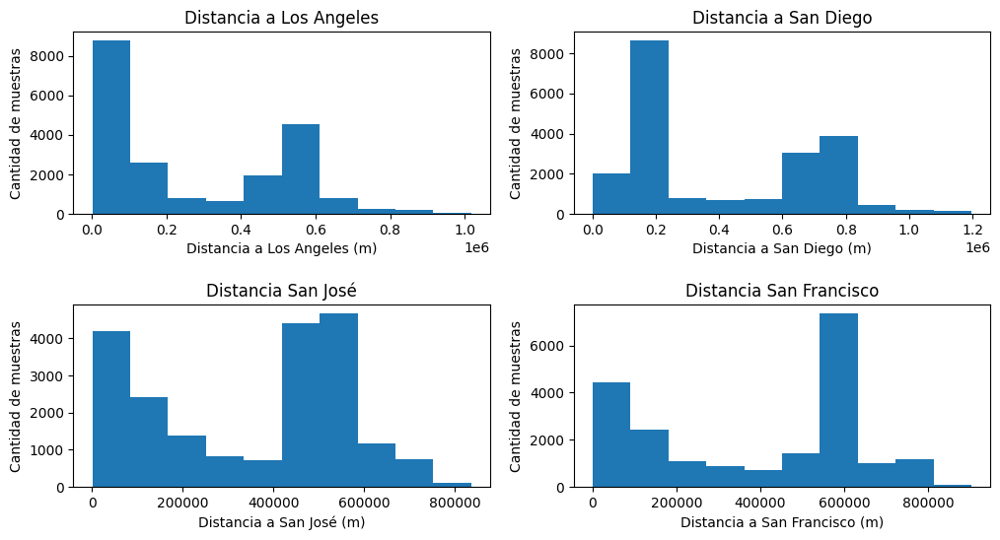

In [182]:
print("\n")
print("En todos los gráficos, mis ejes xy son metros y cantidad de manzanas respectivamente")
print("\n")
fig, ax = plt.subplots(2,2,figsize=(12,6))

ax[0,0].hist(gdf['DistLA'])
ax[0,0].set_title('Distancia a Los Angeles')


ax[0,1].hist(gdf['DistSanDiego'])
ax[0,1].set_title('Distancia a San Diego')

ax[1,0].hist(gdf['DistSanJose'])
ax[1,0].set_title('Distancia San José')

ax[1,1].hist(gdf['DistSanFran'])
ax[1,1].set_title('Distancia San Francisco')

ax[0,0].set_ylabel('Cantidad de muestras')
ax[0,0].set_xlabel('Distancia a Los Angeles (m)')


ax[0,1].set_ylabel('Cantidad de muestras')
ax[0,1].set_xlabel('Distancia a San Diego (m)')


ax[1,0].set_ylabel('Cantidad de muestras')
ax[1,0].set_xlabel('Distancia a San José (m)')


ax[1,1].set_ylabel('Cantidad de muestras')
ax[1,1].set_xlabel('Distancia a San Francisco (m)')

fig.subplots_adjust(hspace=0.5)
plt.show()

Todas estas distancias a las ciudades más importantes muestran la densidad de población en el Estado. Se puede observar, por ejemplo en el gráfico de distancia a San Francisco, que hay más de 4000 manzanas en la ciudad; y a 600km, otro pico. Este último pico representa a Los Angeles, en donde hay una concentración mucho mayor.

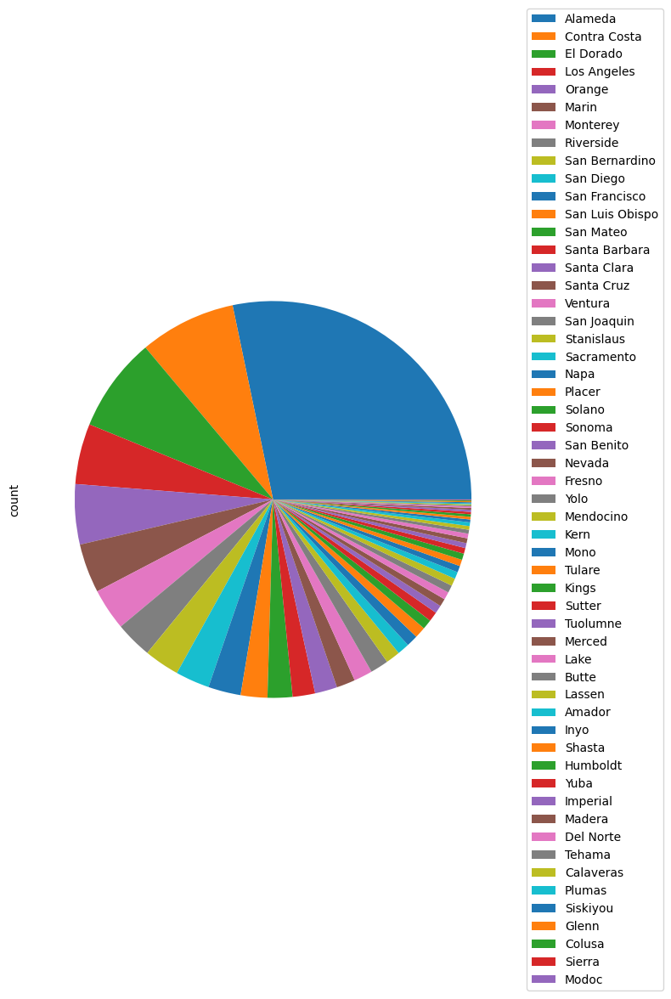

In [183]:
asd = gdf['Ciudad'].value_counts()
asd.plot.pie(figsize=(10,10),labels=None)
plt.legend(gdf['Ciudad'].unique(), loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.tight_layout()

plt.show()

In [184]:
gdf['Ciudad'].unique()

array(['Alameda', 'Contra Costa', 'El Dorado', 'Los Angeles', 'Orange',
       'Marin', 'Monterey', 'Riverside', 'San Bernardino', 'San Diego',
       'San Francisco', 'San Luis Obispo', 'San Mateo', 'Santa Barbara',
       'Santa Clara', 'Santa Cruz', 'Ventura', 'San Joaquin',
       'Stanislaus', 'Sacramento', 'Napa', 'Placer', 'Solano', 'Sonoma',
       'San Benito', 'Nevada', 'Fresno', 'Yolo', 'Mendocino', 'Kern',
       'Mono', 'Tulare', 'Kings', 'Sutter', 'Tuolumne', 'Merced', 'Lake',
       'Butte', 'Lassen', 'Amador', 'Inyo', 'Shasta', 'Humboldt', 'Yuba',
       'Imperial', 'Madera', 'Del Norte', 'Tehama', 'Calaveras', 'Plumas',
       'Siskiyou', 'Glenn', 'Colusa', 'Sierra', 'Modoc'], dtype=object)

Reviso si hay algún outlier a simple vista

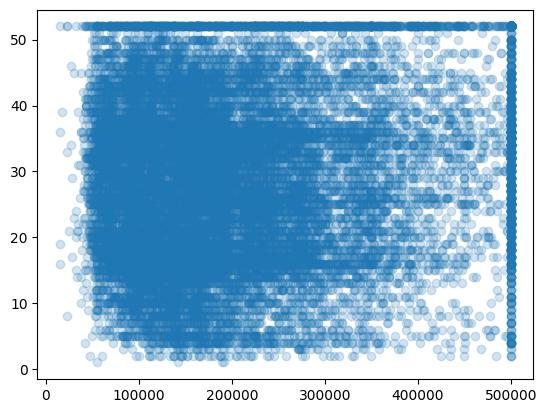

In [185]:
plt.scatter(gdf['MediaPrecioHogar'],gdf['MediaEdad'], alpha= 0.2)

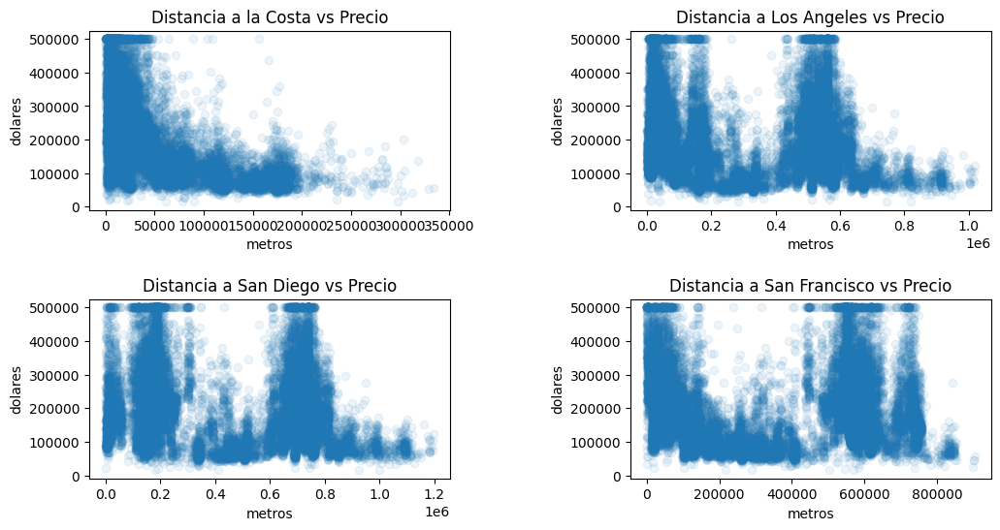

In [186]:
fig, ax = plt.subplots(2,2,figsize=(12,6))
ax[0,0].scatter(gdf['DistCosta'],gdf['MediaPrecioHogar'],alpha=0.08)
ax[0,0].set_title('Distancia a la Costa vs Precio')

ax[0,1].scatter(gdf['DistLA'],gdf['MediaPrecioHogar'],alpha=0.08)
ax[0,1].set_title('Distancia a Los Angeles vs Precio')


ax[1,0].scatter(gdf['DistSanDiego'],gdf['MediaPrecioHogar'],alpha=0.08)
ax[1,0].set_title('Distancia a San Diego vs Precio')

ax[1,1].scatter(gdf['DistSanFran'],gdf['MediaPrecioHogar'],alpha=0.08)
ax[1,1].set_title('Distancia a San Francisco vs Precio')

ax[0,0].set_ylabel('dolares')
ax[0,0].set_xlabel('metros')


ax[0,1].set_ylabel('dolares')
ax[0,1].set_xlabel('metros')


ax[1,0].set_ylabel('dolares')
ax[1,0].set_xlabel('metros')


ax[1,1].set_ylabel('dolares')
ax[1,1].set_xlabel('metros')


fig.subplots_adjust(hspace=0.5,wspace=0.5)
plt.show()

#Limpieza

Reviso cuantas casas tienen un valor entre 500k y 501k y lo mismo para las edades iguales a 52.


Esto debe ocurrir porque en este censo, los valores máximos permitidos fueron estos. De ser el caso, se eliminarán y se considerará un dataset reducido en cuanto a precios y edades promedios por manzana.


In [187]:
print((gdf['MediaPrecioHogar'] > 500000.9).sum())
print((gdf['MediaPrecioHogar'] == 500001).sum())

965
965


In [188]:
gdf = gdf[gdf['MediaPrecioHogar'] != 500001]
gdf['MediaPrecioHogar'].unique()

array([500000., 499100., 499000., ...,  22500.,  17500.,  14999.])

In [189]:
print(gdf[gdf['MediaEdad'] == 52].count())

MediaPrecioHogar    1103
MediaIngresos       1103
MediaEdad           1103
Ambientes           1103
Dormitorios         1103
Poblacion           1103
Familias            1103
Latitud             1103
Longitud            1103
DistCosta           1103
DistLA              1103
DistSanDiego        1103
DistSanJose         1103
DistSanFran         1103
CercaniaOceano      1103
Ciudad              1103
geometry            1103
dtype: int64


In [190]:
gdf = gdf[gdf['MediaEdad'] != 52]

Revisamos si los gráficos se ven mejor.

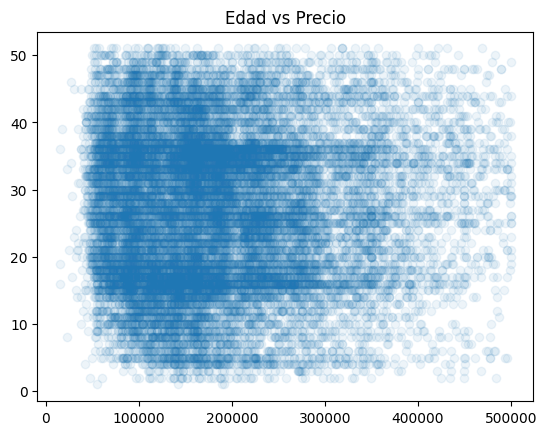

In [191]:
plt.scatter(gdf['MediaPrecioHogar'],gdf['MediaEdad'],alpha=0.08)
plt.title('Edad vs Precio')
plt.show()

Reviso outliers en Población y Familias.

En cuanto a DistCosta,  se dejará como está ya que al analizar el gráfico de las latitudes y longitudes de cada manzana, todas las observaciones se encuentran dentro del estado de California

In [192]:
gdf = gdf.reset_index()


In [193]:
gdf_out = gdf.drop(['MediaPrecioHogar','DistCosta','DistLA' ,'DistSanDiego' ,'DistSanJose' ,'DistSanFran'],axis=1)
gdf_resto = gdf[['MediaPrecioHogar','DistCosta','DistLA' ,'DistSanDiego' ,'DistSanJose' ,'DistSanFran']]
gdf_out = gdf_out.drop(['index'],axis=1)
gdf_out.columns

Index(['MediaIngresos', 'MediaEdad', 'Ambientes', 'Dormitorios', 'Poblacion',
       'Familias', 'Latitud', 'Longitud', 'CercaniaOceano', 'Ciudad',
       'geometry'],
      dtype='object')

In [194]:
gdf_resto.columns

Index(['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran'],
      dtype='object')

In [195]:
gdf_out.head(4)

,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,CercaniaOceano,Ciudad,geometry
0,3.5556,25,2558,661,1183,636,34.06,-118.38,<1H OCEAN,Los Angeles,POINT (-118.38 34.06)
1,2.3536,26,1809,640,2543,640,34.05,-118.31,<1H OCEAN,Los Angeles,POINT (-118.31 34.05)
2,2.2444,20,3367,1264,2667,1131,34.06,-118.45,<1H OCEAN,Los Angeles,POINT (-118.45 34.06)
3,4.7109,32,1880,435,798,417,34.05,-118.44,<1H OCEAN,Los Angeles,POINT (-118.44 34.05)


In [196]:
gdf_resto.head(4)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran
0,500000.0,12557.285120,12587.69033,187479.3090,482918.8189,550918.9388
1,500000.0,18439.981830,6114.78843,182729.5177,487935.7778,555951.3359
2,500000.0,7019.844947,19026.31002,191471.9618,478793.8644,546769.7946
3,500000.0,7097.338532,18088.24466,190028.0445,480237.8585,548213.7876


In [197]:
def outliers_z_score(df, threshold = 3):

    #obtengo el valor medio
    mean = np.mean(df)
    std = np.std(df)
    z_scores = [(y - mean) / std for y in df]
    return np.where(np.abs(z_scores) > threshold)

In [198]:
def eliminar_outliers_combinado(df, threshold=3):

    # Seleccionar columnas numéricas
    numerical_columns = gdf_out.select_dtypes(include=[np.number]).columns

    # Encontrar outliers en cualquier columna
    outlier_indices = set()

    for col in numerical_columns:
        outliers = outliers_z_score(gdf_out[col], threshold)
        outlier_indices.update(outliers[0])  # outliers[0] contiene los índices

    # Filtrar DataFrame
    gdf_limpio = gdf_out[~gdf_out.index.isin(outlier_indices)]

    print(f"Filas originales: {len(df)}")
    print(f"Filas eliminadas: {len(outlier_indices)}")
    print(f"Filas finales: {len(gdf_limpio)}")

    return gdf_limpio

# Usar con un threshold más conservador
gdf_limpio = eliminar_outliers_combinado(gdf, threshold=2.5)

Filas originales: 18572
Filas eliminadas: 1135
Filas finales: 17437


In [199]:
len(gdf_limpio)

17437

In [200]:
len(gdf_resto)

18572

In [201]:
gdf_limpio.describe()

,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud
count,17437.000000,17437.000000,17437.000000,17437.000000,17437.000000,17437.000000,17437.000000,17437.000000
mean,3.588061,27.620806,2357.220623,490.659517,1322.525951,457.816826,35.591668,-119.492756
std,1.415570,11.255217,1359.323000,277.732588,745.355779,255.872427,2.125591,1.968790
min,0.499900,1.000000,2.000000,2.000000,3.000000,2.000000,32.540000,-124.270000
25%,2.515600,18.000000,1427.000000,295.000000,798.000000,280.000000,33.920000,-121.530000
50%,3.411800,28.000000,2073.000000,430.000000,1174.000000,405.000000,34.240000,-118.460000
75%,4.517900,36.000000,3004.000000,626.000000,1694.000000,586.000000,37.670000,-117.990000
max,7.618000,51.000000,8213.000000,1621.000000,4375.000000,1482.000000,40.950000,-114.550000



Reviso Población y Familia

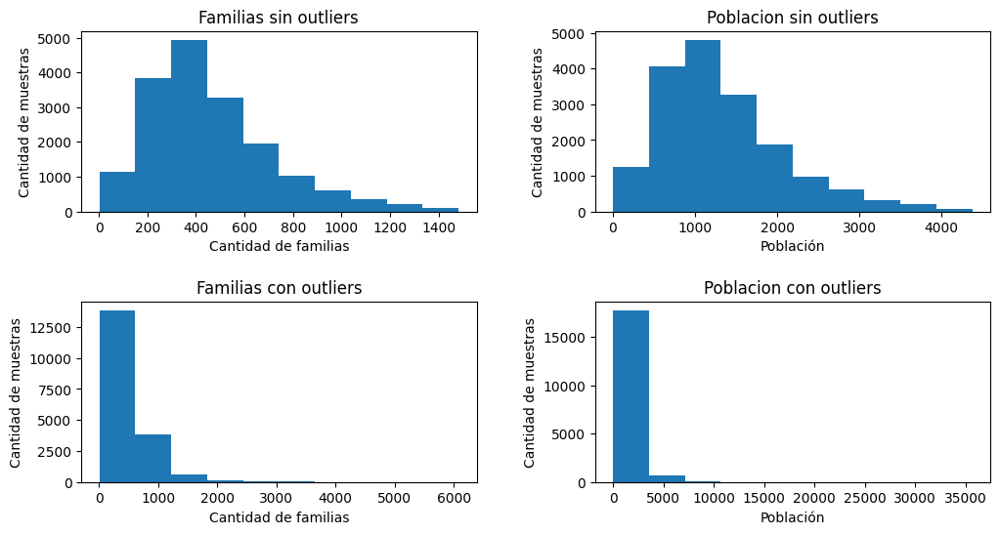

In [202]:

fig, ax = plt.subplots(2,2,figsize=(12,6))




ax[0,0].hist(gdf_limpio['Familias'])
ax[0,0].set_title('Familias sin outliers')
ax[0,0].set_ylabel('Cantidad de muestras')
ax[0,0].set_xlabel('Cantidad de familias')


ax[0,1].hist(gdf_limpio['Poblacion'])
ax[0,1].set_title('Poblacion sin outliers')
ax[0,1].set_ylabel('Cantidad de muestras')
ax[0,1].set_xlabel('Población')


ax[1,0].hist(gdf['Familias'])
ax[1,0].set_title('Familias con outliers')
ax[1,0].set_ylabel('Cantidad de muestras')
ax[1,0].set_xlabel('Cantidad de familias')


ax[1,1].hist(gdf['Poblacion'])
ax[1,1].set_title('Poblacion con outliers')
ax[1,1].set_ylabel('Cantidad de muestras')
ax[1,1].set_xlabel('Población')


fig.subplots_adjust(hspace=0.5,wspace=0.3)
plt.show()

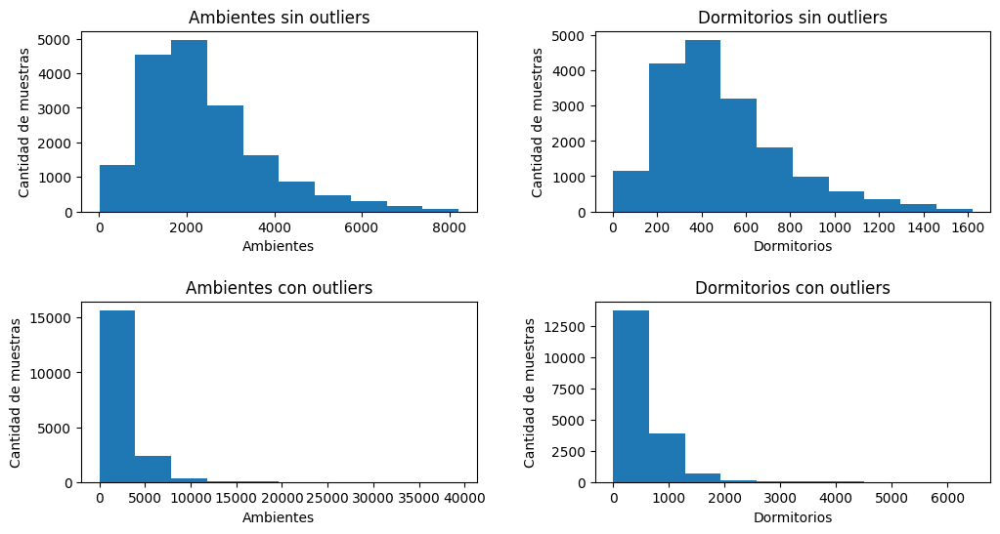

In [203]:
fig, ax = plt.subplots(2,2,figsize=(12,6))




ax[0,0].hist(gdf_limpio['Ambientes'])
ax[0,0].set_title('Ambientes sin outliers')
ax[0,0].set_ylabel('Cantidad de muestras')
ax[0,0].set_xlabel('Ambientes')


ax[0,1].hist(gdf_limpio['Dormitorios'])
ax[0,1].set_title('Dormitorios sin outliers')
ax[0,1].set_ylabel('Cantidad de muestras')
ax[0,1].set_xlabel('Dormitorios')


ax[1,0].hist(gdf['Ambientes'])
ax[1,0].set_title('Ambientes con outliers')
ax[1,0].set_ylabel('Cantidad de muestras')
ax[1,0].set_xlabel('Ambientes')


ax[1,1].hist(gdf['Dormitorios'])
ax[1,1].set_title('Dormitorios con outliers')
ax[1,1].set_ylabel('Cantidad de muestras')
ax[1,1].set_xlabel('Dormitorios')


fig.subplots_adjust(hspace=0.5,wspace=0.3)
plt.show()

In [204]:
gdf_limpio.columns

Index(['MediaIngresos', 'MediaEdad', 'Ambientes', 'Dormitorios', 'Poblacion',
       'Familias', 'Latitud', 'Longitud', 'CercaniaOceano', 'Ciudad',
       'geometry'],
      dtype='object')

Uno el dataframe que acabo de trabajar con el resto de las columnas no trabajadas y lo vuelvo a llamar "gdf".

In [205]:
gdf_limpio.index

Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,     9,
       ...
       18560, 18562, 18563, 18564, 18565, 18566, 18568, 18569, 18570, 18571],
      dtype='int64', length=17437)

In [206]:
indices_comunes = gdf_limpio.index

In [207]:
gdf_filtrado =  gdf_resto.loc[indices_comunes]
gdf = pd.concat([gdf_filtrado, gdf_limpio], axis=1)
gdf = gdf.reset_index()
gdf = gdf.drop(['index'],axis=1)
gdf.tail(2)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,CercaniaOceano,Ciudad,geometry
17435,14999.0,297347.74660,283729.0244,4.098750e+05,445744.2779,503631.7185,2.100,19,619,239,490,164,36.40,-117.02,INLAND,Kern,POINT (-117.02 36.4)
17436,14999.0,78672.51753,821033.8062,1.000130e+06,348749.4709,289116.4984,0.536,36,98,28,18,8,40.31,-123.17,INLAND,Shasta,POINT (-123.17 40.31)


In [208]:
gdf.columns

Index(['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias', 'Latitud', 'Longitud',
       'CercaniaOceano', 'Ciudad', 'geometry'],
      dtype='object')

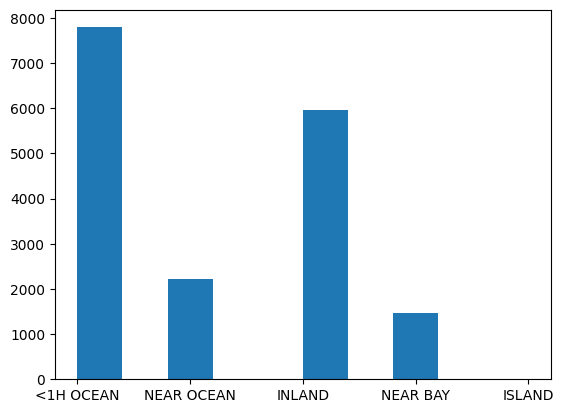

In [209]:
plt.hist(gdf['CercaniaOceano'])
plt.show()

In [210]:
gdf[gdf['CercaniaOceano'] == 'ISLAND'].count()

,0
MediaPrecioHogar,2
DistCosta,2
DistLA,2
DistSanDiego,2
DistSanJose,2
DistSanFran,2
MediaIngresos,2
MediaEdad,2
Ambientes,2
Dormitorios,2


In [211]:
gdf['CercaniaOceano'].unique()

array(['<1H OCEAN', 'NEAR OCEAN', 'INLAND', 'NEAR BAY', 'ISLAND'],
      dtype=object)

No parecen ser muy útiles ya que no son datos precisos. La diferencia entre "Cerca del océano" y "A menos de una hora del océano" no es clara. Por este motivo, y el hecho de tener otro atributo como "Distancia a la costa", la excluiremos del análisis.


In [212]:
gdf = gdf.drop('CercaniaOceano', axis=1)


In [213]:
gdf['Ciudad'].unique()

array(['Los Angeles', 'Monterey', 'Orange', 'San Bernardino', 'San Diego',
       'San Francisco', 'San Mateo', 'Santa Barbara', 'Marin',
       'Contra Costa', 'Riverside', 'Alameda', 'Santa Clara',
       'San Joaquin', 'Stanislaus', 'Ventura', 'Sacramento', 'Santa Cruz',
       'El Dorado', 'Napa', 'Placer', 'Sonoma', 'San Luis Obispo',
       'San Benito', 'Nevada', 'Solano', 'Yolo', 'Mendocino', 'Kern',
       'Fresno', 'Mono', 'Tulare', 'Kings', 'Sutter', 'Tuolumne',
       'Merced', 'Lake', 'Lassen', 'Amador', 'Inyo', 'Butte', 'Shasta',
       'Humboldt', 'Yuba', 'Imperial', 'Madera', 'Tehama', 'Calaveras',
       'Plumas', 'Glenn', 'Colusa', 'Sierra', 'Siskiyou'], dtype=object)

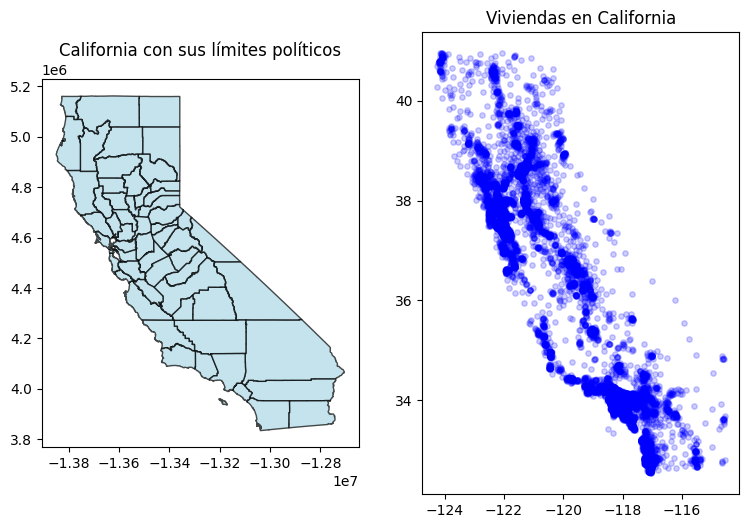

In [214]:
gdf2 = gpd.read_file(url2)

polygons = gdf2[gdf2.geometry.type == 'Polygon']
multi_polygons = gdf2[gdf2.geometry.type == 'MultiPolygon']

multi_polygons1 = pd.concat([polygons,multi_polygons])

fig, ax = plt.subplots(1,2,figsize=(9,6))
multi_polygons1.plot(ax=ax[0], color='lightblue', edgecolor='black', alpha=0.7)
ax[0].set_title('California con sus límites políticos')

ax[1].scatter(gdf['Longitud'],gdf['Latitud'], color='blue', s=15, alpha= 0.2)
ax[1].set_title('Viviendas en California')
plt.show()

Dividiremos a las manzanas basandonos en su latitud.

California tiene una extensión aproximada entre las latitudes 32.5°N y 42°N.

Su centro geográfico se encuentra aproximadamente en latitud 37.25°N

In [215]:
print("Latitud maxima:", gdf['Latitud'].max())

print("Latitud media:", gdf['Latitud'].mean())

print("Latitud mínima:", gdf['Latitud'].min())

Latitud maxima: 40.95
Latitud media: 35.59166771807077
Latitud mínima: 32.54


In [216]:
(gdf['Latitud'].max() - gdf['Latitud'].min())/3

2.8033333333333346

Se generarán 3 categorias en las que se dividirá al Estado en franjas de igual latitud.

    Sur: [32.5°N, 35.3°N]
    Centro: (35.3°N, 38.1°N]
    Norte: (38.1°N, 41°N]




In [217]:
conds = [
    gdf['Latitud'] > 38.1,
    gdf['Latitud'] <= 35.3
]

opciones = ['Norte', 'Sur']

gdf['Region'] = np.select(conds, opciones, default='Centro')

En este caso, al dividir la latitud en franjas iguales, se ignoró la concentración de casas para tener una mejor relación geográfica entre los datos.

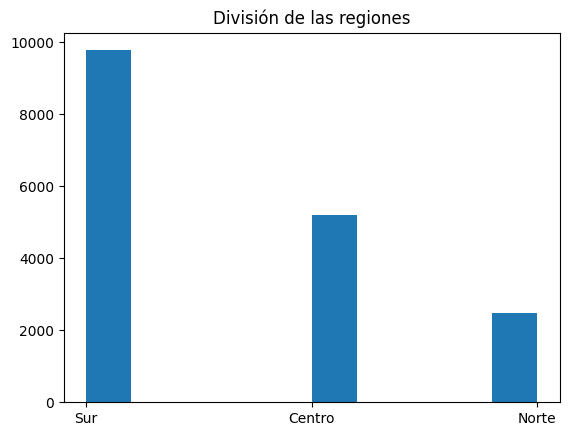

In [218]:
plt.hist(gdf['Region'])
plt.title('División de las regiones')
plt.show()

In [219]:
gdf = gdf.drop(['Ciudad'],axis=1)

In [220]:
gdf.head(10)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,geometry,Region
0,500000.0,12557.285120,12587.69033,187479.3090,482918.81890,550918.9388,3.5556,25,2558,661,1183,636,34.06,-118.38,POINT (-118.38 34.06),Sur
1,500000.0,18439.981830,6114.78843,182729.5177,487935.77780,555951.3359,2.3536,26,1809,640,2543,640,34.05,-118.31,POINT (-118.31 34.05),Sur
2,500000.0,7019.844947,19026.31002,191471.9618,478793.86440,546769.7946,2.2444,20,3367,1264,2667,1131,34.06,-118.45,POINT (-118.45 34.06),Sur
3,500000.0,7097.338532,18088.24466,190028.0445,480237.85850,548213.7876,4.7109,32,1880,435,798,417,34.05,-118.44,POINT (-118.44 34.05),Sur
4,500000.0,34737.508110,11454.68338,181121.3211,491841.89830,559875.3280,6.0199,49,1789,288,848,311,34.12,-118.15,POINT (-118.15 34.12),Sur
5,500000.0,3416.385053,37741.79837,145273.0105,525008.34570,592965.4051,3.6250,29,2743,708,1059,651,33.72,-118.16,POINT (-118.16 33.72),Sur
6,500000.0,3093.236522,22539.35570,188139.0299,482225.37310,550160.8492,3.6121,29,1727,479,741,431,34.00,-118.48,POINT (-118.48 34),Sur
7,500000.0,2086.539029,437516.59180,612799.1794,84109.15398,139716.2540,6.7770,23,4911,693,1480,606,36.58,-121.94,POINT (-121.94 36.58),Centro
8,500000.0,3998.576124,435462.57340,611080.2848,81782.08708,139067.2236,1.2656,19,656,200,248,173,36.60,-121.89,POINT (-121.89 36.6),Centro
9,500000.0,7909.606534,60993.43139,118417.2261,552386.37400,620397.3597,5.1155,35,1598,398,782,411,33.60,-117.87,POINT (-117.87 33.6),Sur


Al dividir en estas categorías a "Ciudades", además, se intentó no dividir a nunguna ciudad de las más importantes en dos.

In [221]:
gdf = gdf.reset_index(drop=True)
gdf.tail(3)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Latitud,Longitud,geometry,Region
17434,14999.0,89894.93543,745210.3430,9.243866e+05,274118.5835,216934.5211,1.6607,16,255,73,85,38,39.71,-122.74,POINT (-122.74 39.71),Norte
17435,14999.0,297347.74660,283729.0244,4.098750e+05,445744.2779,503631.7185,2.1000,19,619,239,490,164,36.40,-117.02,POINT (-117.02 36.4),Centro
17436,14999.0,78672.51753,821033.8062,1.000130e+06,348749.4709,289116.4984,0.5360,36,98,28,18,8,40.31,-123.17,POINT (-123.17 40.31),Norte


Me deshago de los siguientes 3 atributos ya que no tendrán ningún uso.

In [222]:
gdf = gdf.drop(['Latitud'],axis=1)
gdf = gdf.drop(['Longitud'],axis=1)
gdf = gdf.drop(['geometry'],axis=1)

In [223]:
from google.colab import data_table
data_table.DataTable(gdf, num_rows_per_page = 15)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,12557.285120,12587.69033,1.874793e+05,482918.81890,550918.9388,3.5556,25,2558,661,1183,636,Sur
1,500000.0,18439.981830,6114.78843,1.827295e+05,487935.77780,555951.3359,2.3536,26,1809,640,2543,640,Sur
2,500000.0,7019.844947,19026.31002,1.914720e+05,478793.86440,546769.7946,2.2444,20,3367,1264,2667,1131,Sur
3,500000.0,7097.338532,18088.24466,1.900280e+05,480237.85850,548213.7876,4.7109,32,1880,435,798,417,Sur
4,500000.0,34737.508110,11454.68338,1.811213e+05,491841.89830,559875.3280,6.0199,49,1789,288,848,311,Sur
...,...,...,...,...,...,...,...,...,...,...,...,...,...
17432,22500.0,3898.789930,565923.71890,7.448498e+05,76051.74719,19912.1548,2.6750,33,296,73,216,63,Centro
17433,17500.0,21926.839290,13466.35773,1.928705e+05,478320.29920,546350.0596,2.3667,39,493,168,259,138,Sur
17434,14999.0,89894.935430,745210.34300,9.243866e+05,274118.58350,216934.5211,1.6607,16,255,73,85,38,Norte
17435,14999.0,297347.746600,283729.02440,4.098750e+05,445744.27790,503631.7185,2.1000,19,619,239,490,164,Centro


MediaPrecioHogar: Valor medio de los edificios o casas ubicados en la manzana.

DistCosta: Distancia al oceano en metros.

Dist Ciudades: Distancia a la ciudad mencionada en metros.

MediaIngresos: Refiere a la media de los ingresos de las familias que viven en esa manzana. Medido en miles de dolares.

MediaEdad: Edad media de una casa en una manzana. Más alto = Más viejo

Ambientes: Media de habitaciones en una manzana

Dormitorios: Media de habitaciones destinadas a dormir en una manzana

Poblacion: Gente viviendo en una manzana

Familias: Cantidad de familias o grupos de personas que viven en esa manzana

Región: Región en la que se encuentra

In [224]:
gdf.columns

Index(['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias', 'Region'],
      dtype='object')

Dataset está lo suficientemente limpio para empezara generar categorías.

Se van a hacer dos dataframes. Uno para exportar, con mis variables categóricas como "strings", y otra como "enteros". Esto es para poder seguir trabajando en python y a la vez poder usar otro programa como Weka.

El código va a mostrar algo como "[2.  10.   15.  55.], 'Bajo, Medio, Alto'". En este caso significa que entre 2 y 10 estoy dentro de mi categoría "Bajo", entre 10 y 15 estoy en "Medio", etc.

In [225]:
gdf2 = gdf.copy()

categorias = pd.qcut(gdf2['DistCosta'], q=3, retbins=True)
print("Límites de la categoria DistCosta:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos'")
gdf2['DistCosta'] = pd.qcut(gdf2['DistCosta'], q=3, labels=['Muy Cerca', 'Cerca', 'Lejos'])
categorias = pd.qcut(gdf2['DistLA'], q=4, retbins=True)
print("Límites de la categoría DistLA:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf2['DistLA'] = pd.qcut(gdf2['DistLA'], q=4, labels=['Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'])
categorias = pd.qcut(gdf2['DistSanDiego'], q=4, retbins=True)
print("Límites de la categoría DistSanDiego:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf2['DistSanDiego'] = pd.qcut(gdf2['DistSanDiego'], q=4, labels=['Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'])
categorias = pd.qcut(gdf2['DistSanJose'], q=4, retbins=True)
print("Límites de la categoría DistSanJosé:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf2['DistSanJose'] = pd.qcut(gdf2['DistSanJose'], q=4, labels=['Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'])
categorias = pd.qcut(gdf2['DistSanFran'], q=4, retbins=True)
print("Límites de la categoría DistSanFran:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf2['DistSanFran'] = pd.qcut(gdf2['DistSanFran'], q=4, labels=['Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'])
categorias = pd.qcut(gdf2['MediaIngresos'], q=3, retbins=True)
print("Límites de la categoría MediaIngresos:", categorias[1],"'Bajos', 'Medios', 'Altos'")
gdf2['MediaIngresos'] = pd.qcut(gdf2['MediaIngresos'], q=3, labels=['Bajos', 'Medios', 'Altos'])
categorias = pd.qcut(gdf2['MediaEdad'], q=3, retbins=True)
print("Límites de la categoría MediaEdad:", categorias[1],"'Joven', 'Adulto', 'Adulto Mayor'")
gdf2['MediaEdad'] = pd.qcut(gdf2['MediaEdad'], q=3, labels=['Joven', 'Adulto', 'Adulto Mayor'])
categorias = pd.qcut(gdf2['Dormitorios'], q=3, retbins=True)
print("Límites de la categoría Dormitorios:", categorias[1],"'Muy Pocos', 'Pocos', 'Muchos'")
gdf2['Dormitorios'] = pd.qcut(gdf2['Dormitorios'], q=3, labels=['Muy Pocos', 'Pocos', 'Muchos'])
categorias = pd.qcut(gdf2['Ambientes'], q=3, retbins=True)
print("Límites de la categoría Ambientes:", categorias[1],"'Muy Pocos', 'Pocos', 'Muchos'")
gdf2['Ambientes'] = pd.qcut(gdf2['Ambientes'], q=3, labels=['Muy Pocos', 'Pocos', 'Muchos'])
categorias = pd.qcut(gdf2['Poblacion'], q=3, retbins=True)
print("Límites de la categoría Poblacion:", categorias[1],"'Baja', 'Media', 'Alta'")
gdf2['Poblacion'] = pd.qcut(gdf2['Poblacion'], q=3, labels=['Baja', 'Media', 'Alta'])
categorias = pd.qcut(gdf2['Familias'], q=3, retbins=True)
print("Límites de la categoría Familias:", categorias[1],"'Baja', 'Media', 'Alta'")
gdf2['Familias'] = pd.qcut(gdf2['Familias'], q=3, labels=['Baja', 'Media', 'Alta'])


Límites de la categoria DistCosta: [1.20676447e+02 1.45373649e+04 3.52331715e+04 3.18121295e+05] 'Muy Cerca', 'Cerca', 'Lejos'
Límites de la categoría DistLA: [4.20589109e+02 3.17210768e+04 1.72765858e+05 5.17336504e+05
 9.27186106e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'
Límites de la categoría DistSanDiego: [4.84917973e+02 1.58288243e+05 2.11185055e+05 6.96114345e+05
 1.10651309e+06] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'
Límites de la categoría DistSanJosé: [5.69448118e+02 1.37674961e+05 4.61242769e+05 5.18273215e+05
 8.36762678e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'
Límites de la categoría DistSanFran: [6.79906897e+02 1.29044409e+05 5.29269028e+05 5.86287413e+05
 9.03627663e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'
Límites de la categoría MediaIngresos: [0.4999 2.8071 4.0931 7.618 ] 'Bajos', 'Medios', 'Altos'
Límites de la categoría MediaEdad: [ 1. 22. 34. 51.] 'Joven', 'Adulto', 'Adulto Mayor'
Límites de la categoría Dormitorios: [   2.  340.  547. 1621.]

Como se puede observar, la herramienta divide las muestras en partes iguales y las categoriza.

Todas las columnas están categorizadas de esta manera exceptuando a "Region"

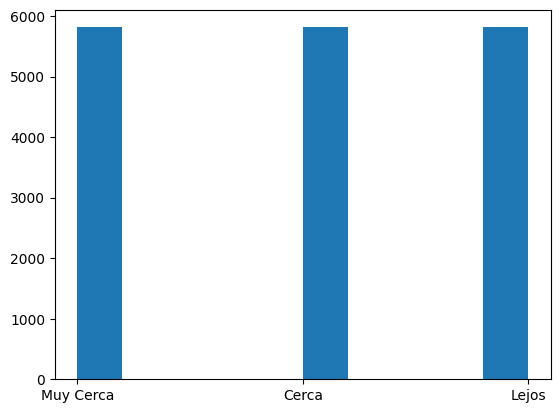

In [226]:
plt.hist(gdf2['DistCosta'])

plt.show()

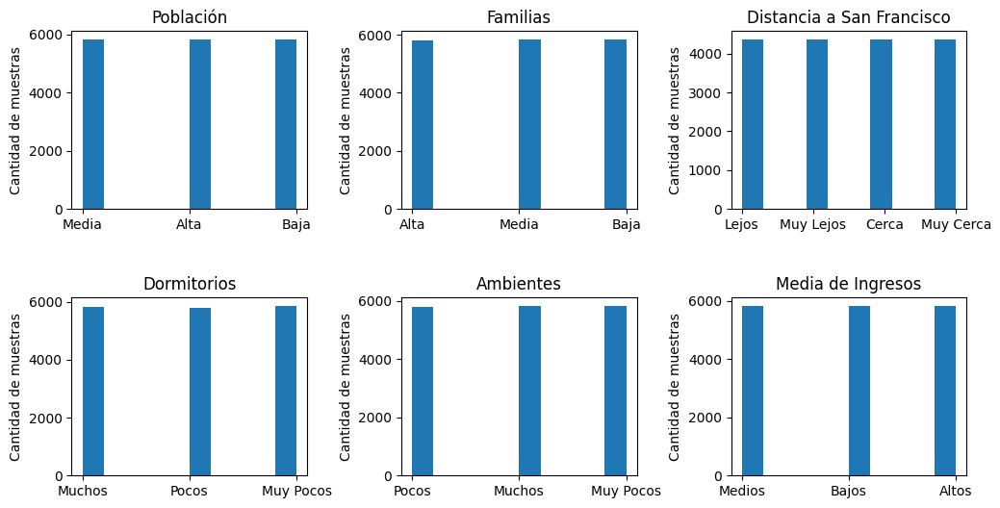

In [227]:
fig, ax = plt.subplots(2,3,figsize=(12,6))

ax[0,0].hist(gdf2['Poblacion'])
ax[0,0].set_title('Población')

ax[0,1].hist(gdf2['Familias'])
ax[0,1].set_title('Familias')

ax[1,0].hist(gdf2['Dormitorios'])
ax[1,0].set_title('Dormitorios')

ax[1,1].hist(gdf2['Ambientes'])
ax[1,1].set_title('Ambientes')

ax[0,2].hist(gdf2['DistSanFran'])
ax[0,2].set_title('Distancia a San Francisco')

ax[1,2].hist(gdf2['MediaIngresos'])
ax[1,2].set_title('Media de Ingresos')

ax[0,0].set_ylabel('Cantidad de muestras')
ax[0,1].set_ylabel('Cantidad de muestras')
ax[1,0].set_ylabel('Cantidad de muestras')
ax[1,1].set_ylabel('Cantidad de muestras')
ax[0,2].set_ylabel('Cantidad de muestras')
ax[1,2].set_ylabel('Cantidad de muestras')

fig.subplots_adjust(hspace=0.5,wspace=0.4)
plt.show()

In [228]:
gdf3 = gdf.copy()

In [229]:
gdf3.head(2)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,12557.28512,12587.69033,187479.3090,482918.8189,550918.9388,3.5556,25,2558,661,1183,636,Sur
1,500000.0,18439.98183,6114.78843,182729.5177,487935.7778,555951.3359,2.3536,26,1809,640,2543,640,Sur


In [230]:
categorias = pd.qcut(gdf3['DistCosta'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos'")
gdf3['DistCosta'] = pd.qcut(gdf3['DistCosta'], q=3, labels=[1,2,3])

Límites de las categorías: [1.20676447e+02 1.45373649e+04 3.52331715e+04 3.18121295e+05] 'Muy Cerca', 'Cerca', 'Lejos'


In [231]:
categorias = pd.qcut(gdf3['DistLA'], q=4, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf3['DistLA'] = pd.qcut(gdf3['DistLA'], q=4, labels=[1,2,3,4])

Límites de las categorías: [4.20589109e+02 3.17210768e+04 1.72765858e+05 5.17336504e+05
 9.27186106e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'


In [232]:
categorias = pd.qcut(gdf3['DistSanDiego'], q=4, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf3['DistSanDiego'] = pd.qcut(gdf3['DistSanDiego'], q=4, labels=[1,2,3,4])

Límites de las categorías: [4.84917973e+02 1.58288243e+05 2.11185055e+05 6.96114345e+05
 1.10651309e+06] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'


In [233]:
categorias = pd.qcut(gdf3['DistSanJose'], q=4, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf3['DistSanJose'] = pd.qcut(gdf3['DistSanJose'], q=4, labels=[1,2,3,4])

Límites de las categorías: [5.69448118e+02 1.37674961e+05 4.61242769e+05 5.18273215e+05
 8.36762678e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'


In [234]:
categorias = pd.qcut(gdf3['DistSanFran'], q=4, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'")
gdf3['DistSanFran'] = pd.qcut(gdf3['DistSanFran'], q=4, labels=[1,2,3,4])

Límites de las categorías: [6.79906897e+02 1.29044409e+05 5.29269028e+05 5.86287413e+05
 9.03627663e+05] 'Muy Cerca', 'Cerca', 'Lejos', 'Muy Lejos'


In [235]:
categorias = pd.qcut(gdf3['MediaIngresos'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Bajos', 'Medios', 'Altos'")
gdf3['MediaIngresos'] = pd.qcut(gdf3['MediaIngresos'], q=3, labels=[1,2,3])

Límites de las categorías: [0.4999 2.8071 4.0931 7.618 ] 'Bajos', 'Medios', 'Altos'


In [236]:
categorias = pd.qcut(gdf3['MediaEdad'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Joven', 'Adulto', 'Adulto Mayor'")
gdf3['MediaEdad'] = pd.qcut(gdf3['MediaEdad'], q=3, labels=[1,2,3])

Límites de las categorías: [ 1. 22. 34. 51.] 'Joven', 'Adulto', 'Adulto Mayor'


In [237]:
categorias = pd.qcut(gdf3['Dormitorios'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Pocos', 'Pocos', 'Muchos'")
gdf3['Dormitorios'] = pd.qcut(gdf3['Dormitorios'], q=3, labels=[1,2,3])

Límites de las categorías: [   2.  340.  547. 1621.] 'Muy Pocos', 'Pocos', 'Muchos'


In [238]:
categorias = pd.qcut(gdf3['Ambientes'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Muy Pocos', 'Pocos', 'Muchos'")
gdf3['Ambientes'] = pd.qcut(gdf3['Ambientes'], q=3, labels=[1,2,3])

Límites de las categorías: [2.000e+00 1.631e+03 2.629e+03 8.213e+03] 'Muy Pocos', 'Pocos', 'Muchos'


In [239]:
categorias = pd.qcut(gdf3['Poblacion'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Baja', 'Media', 'Alta'")
gdf3['Poblacion'] = pd.qcut(gdf3['Poblacion'], q=3, labels=[1,2,3])

Límites de las categorías: [3.000e+00 9.180e+02 1.490e+03 4.375e+03] 'Baja', 'Media', 'Alta'


In [240]:
categorias = pd.qcut(gdf3['Familias'], q=3, retbins=True)
print("Límites de las categorías:", categorias[1],"'Baja', 'Media', 'Alta'")
gdf3['Familias'] = pd.qcut(gdf3['Familias'], q=3, labels=[1,2,3])

Límites de las categorías: [   2.  321.  512. 1482.] 'Baja', 'Media', 'Alta'


(array([5814.,    0.,    0.,    0.,    0., 5812.,    0.,    0.,    0.,
        5811.]),
 array([1. , 1.2, 1.4, 1.6, 1.8, 2. , 2.2, 2.4, 2.6, 2.8, 3. ]),
 <BarContainer object of 10 artists>)

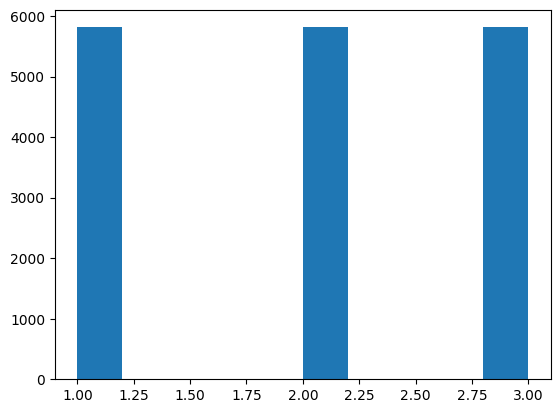

In [241]:
plt.hist(gdf3['DistCosta'])

In [242]:
gdf3.head(3)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,1,1,2,3,3,2,2,2,3,2,3,Sur
1,500000.0,2,1,2,3,3,1,2,2,3,3,3,Sur
2,500000.0,1,1,2,3,3,1,1,3,3,3,3,Sur


Todos mis atributos se encuentran categorizados.

In [243]:
gdf2.head(3)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Medios,Adulto,Pocos,Muchos,Media,Alta,Sur
1,500000.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Adulto,Pocos,Muchos,Alta,Alta,Sur
2,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Joven,Muchos,Muchos,Alta,Alta,Sur


In [244]:
gdf['Region'].describe()

,Region
count,17437
unique,3
top,Sur
freq,9772


In [245]:
region_mapeo = {'Sur': 1, 'Centro': 2, 'Norte': 3}
gdf3['Cod_Region'] = gdf3['Region'].map(region_mapeo)
gdf3= gdf3.drop(['Region'],axis=1)
gdf3.head(3)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Cod_Region
0,500000.0,1,1,2,3,3,2,2,2,3,2,3,1
1,500000.0,2,1,2,3,3,1,2,2,3,3,3,1
2,500000.0,1,1,2,3,3,1,1,3,3,3,3,1


Tenemos los dos dataframes listos para el modelaje. Se seguirá trabajando en python con "gdf3".

In [246]:
gdf2_sample = gdf2.head(5000)
gdf2_sample.head()

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Medios,Adulto,Pocos,Muchos,Media,Alta,Sur
1,500000.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Adulto,Pocos,Muchos,Alta,Alta,Sur
2,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Joven,Muchos,Muchos,Alta,Alta,Sur
3,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto,Pocos,Pocos,Baja,Media,Sur
4,500000.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto Mayor,Pocos,Muy Pocos,Baja,Baja,Sur


In [247]:
gdf2_shuffle = gdf2_sample.sample(frac=1).reset_index(drop=True)
gdf2_shuffle.head()

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,430000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto,Pocos,Pocos,Media,Media,Sur
1,245600.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Medios,Adulto,Muchos,Muchos,Alta,Alta,Sur
2,308500.0,Muy Cerca,Muy Lejos,Muy Lejos,Muy Cerca,Muy Cerca,Medios,Adulto Mayor,Pocos,Pocos,Media,Media,Centro
3,277300.0,Cerca,Lejos,Lejos,Muy Cerca,Muy Cerca,Medios,Adulto,Muchos,Muchos,Alta,Alta,Centro
4,260100.0,Cerca,Lejos,Lejos,Muy Cerca,Muy Cerca,Altos,Adulto,Muy Pocos,Muy Pocos,Baja,Baja,Centro


In [248]:
gdf2_shuffle.columns

Index(['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias', 'Region'],
      dtype='object')

In [249]:

gdf2_shuffle = gdf2_shuffle.loc[:, ['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias','Region']]
gdf2_shuffle.head()

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,430000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto,Pocos,Pocos,Media,Media,Sur
1,245600.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Medios,Adulto,Muchos,Muchos,Alta,Alta,Sur
2,308500.0,Muy Cerca,Muy Lejos,Muy Lejos,Muy Cerca,Muy Cerca,Medios,Adulto Mayor,Pocos,Pocos,Media,Media,Centro
3,277300.0,Cerca,Lejos,Lejos,Muy Cerca,Muy Cerca,Medios,Adulto,Muchos,Muchos,Alta,Alta,Centro
4,260100.0,Cerca,Lejos,Lejos,Muy Cerca,Muy Cerca,Altos,Adulto,Muy Pocos,Muy Pocos,Baja,Baja,Centro


In [250]:
#gdf2_shuffle.to_csv("datos_tp_final22.csv",index=False)

Generamos archivo csv con mis datos categorizados de manera clara.

Seguimos trabajando en python.

In [251]:
gdf = gdf3.copy()

In [252]:
gdf.columns

Index(['MediaPrecioHogar', 'DistCosta', 'DistLA', 'DistSanDiego',
       'DistSanJose', 'DistSanFran', 'MediaIngresos', 'MediaEdad', 'Ambientes',
       'Dormitorios', 'Poblacion', 'Familias', 'Cod_Region'],
      dtype='object')

In [253]:
#gdf['MediaPrecioHogar'] = gdf['MediaPrecioHogar']/1000

In [254]:
data_table.DataTable(gdf2, num_rows_per_page = 9)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Region
0,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Medios,Adulto,Pocos,Muchos,Media,Alta,Sur
1,500000.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Adulto,Pocos,Muchos,Alta,Alta,Sur
2,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Joven,Muchos,Muchos,Alta,Alta,Sur
3,500000.0,Muy Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto,Pocos,Pocos,Baja,Media,Sur
4,500000.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Altos,Adulto Mayor,Pocos,Muy Pocos,Baja,Baja,Sur
...,...,...,...,...,...,...,...,...,...,...,...,...,...
17432,22500.0,Muy Cerca,Muy Lejos,Muy Lejos,Muy Cerca,Muy Cerca,Bajos,Adulto,Muy Pocos,Muy Pocos,Baja,Baja,Centro
17433,17500.0,Cerca,Muy Cerca,Cerca,Lejos,Lejos,Bajos,Adulto Mayor,Muy Pocos,Muy Pocos,Baja,Baja,Sur
17434,14999.0,Lejos,Muy Lejos,Muy Lejos,Cerca,Cerca,Bajos,Joven,Muy Pocos,Muy Pocos,Baja,Baja,Norte
17435,14999.0,Lejos,Lejos,Lejos,Cerca,Cerca,Bajos,Joven,Muy Pocos,Muy Pocos,Baja,Baja,Centro


In [255]:
data_table.DataTable(gdf, num_rows_per_page = 9)

,MediaPrecioHogar,DistCosta,DistLA,DistSanDiego,DistSanJose,DistSanFran,MediaIngresos,MediaEdad,Ambientes,Dormitorios,Poblacion,Familias,Cod_Region
0,500000.0,1,1,2,3,3,2,2,2,3,2,3,1
1,500000.0,2,1,2,3,3,1,2,2,3,3,3,1
2,500000.0,1,1,2,3,3,1,1,3,3,3,3,1
3,500000.0,1,1,2,3,3,3,2,2,2,1,2,1
4,500000.0,2,1,2,3,3,3,3,2,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
17432,22500.0,1,4,4,1,1,1,2,1,1,1,1,2
17433,17500.0,2,1,2,3,3,1,3,1,1,1,1,1
17434,14999.0,3,4,4,2,2,1,1,1,1,1,1,3
17435,14999.0,3,3,3,2,2,1,1,1,1,1,1,2


#Modelado

Se trabajará con un arbol de deciciones ya que es lo que mejor se adapta al dataset.

Se intentará predecir un precio basandonos en cada una de nuestras categorías y obtener cuanto influye cada una en el proceso.

Separo el dataset en test y train.

In [256]:
X = gdf.drop('MediaPrecioHogar', axis=1)
y = gdf['MediaPrecioHogar']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

Linear regression

In [257]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [258]:
y_pred = model.predict(X_test)
print(f"Predicciones: {y_pred}")

Predicciones: [152479.89249098 183556.74515058 127845.446833   ... 222601.31865831
 135069.26408237 176217.06453951]


In [259]:
r2_score(y_test, y_pred)
#Mientras más cerca de 1, mejor

0.5069549281972459

Forest regressor


In [260]:
from sklearn.ensemble import RandomForestRegressor

In [261]:
regressor = RandomForestRegressor(n_estimators=100, random_state=42, oob_score=True,max_depth=None)

In [262]:

regressor.fit(X_train, y_train)



RandomForestRegressor(oob_score=True, random_state=42)

In [263]:

y_pred = regressor.predict(X_test)


r2s = r2_score(y_test, y_pred)
print(f"R2 Score: {r2s:.2f}")
print(f"Out-of-Bag Score: {regressor.oob_score_:.2f}")

R2 Score: 0.53
Out-of-Bag Score: 0.56


In [264]:
predictions = model.predict(X_test)

In [265]:
print("Valores reales:", y_test.values)
print("Predicción:", predictions)

Valores reales: [147300. 150000. 164500. ... 189600. 222900. 165100.]
Predicción: [152479.89249098 183556.74515058 127845.446833   ... 222601.31865831
 135069.26408237 176217.06453951]


In [266]:
data = {'Real': y_test.values, 'Prediccion': predictions.round()}
prediccionesdf = pd.DataFrame(data)

In [267]:
prediccionesdf.sample(10)

,Real,Prediccion
751,384700.0,205274.0
3134,168800.0,180064.0
1146,159700.0,205274.0
3319,67900.0,172349.0
349,240500.0,231233.0
1949,90400.0,166233.0
3421,271100.0,265111.0
1242,99100.0,135303.0
827,132800.0,188309.0
2314,312400.0,301234.0


10 VARIABLES MÁS IMPORTANTES EN EL ÁRBOL:
MediaIngresos                  |  59.26%
DistCosta                      |  28.38%
DistLA                         |   6.59%
MediaEdad                      |   2.23%
DistSanDiego                   |   1.26%
Ambientes                      |   0.98%
Dormitorios                    |   0.84%
DistSanJose                    |   0.23%
Cod_Region                     |   0.16%
Poblacion                      |   0.06%


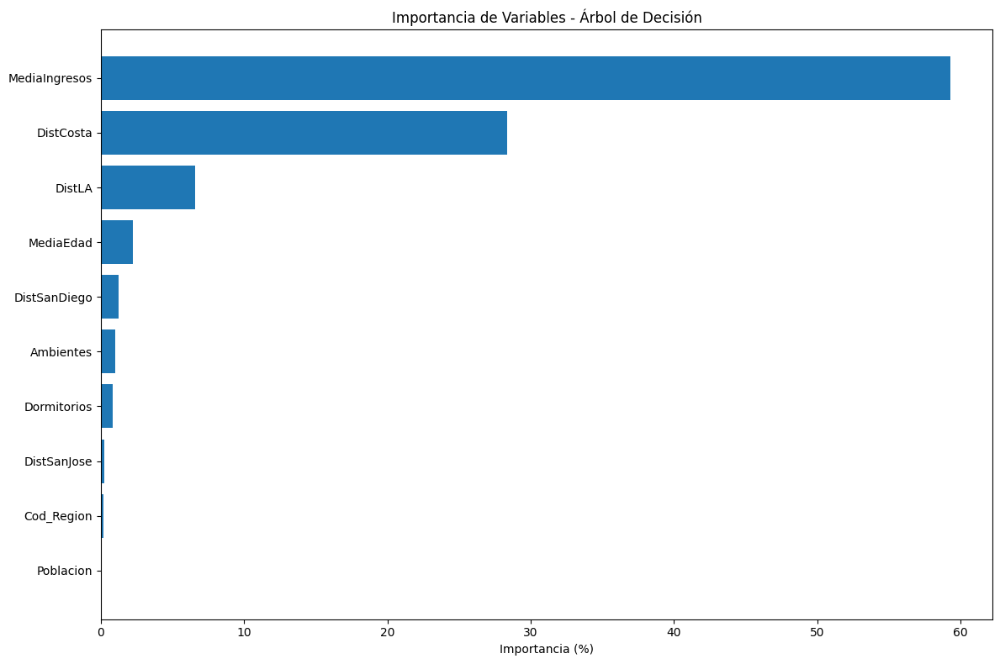

In [281]:
tree_prof = DecisionTreeRegressor(max_depth=5, random_state=42)
tree_prof.fit(X_train, y_train)

# Importancia de variables del árbol
importancia_df = pd.DataFrame({
    'Variable': X.columns,
    'Importancia': tree_prof.feature_importances_
}).sort_values('Importancia', ascending=False)

print("10 VARIABLES MÁS IMPORTANTES EN EL ÁRBOL:")
print("="*50)
for i, row in importancia_df.head(10).iterrows():
    print(f"{row['Variable']:30} | {row['Importancia']*100:6.2f}%")

# Visualizar importancia
plt.figure(figsize=(12, 8))
top_features = importancia_df.head(10)
plt.barh(top_features['Variable'], top_features['Importancia']*100)
plt.xlabel('Importancia (%)')
plt.title('Importancia de Variables - Árbol de Decisión')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

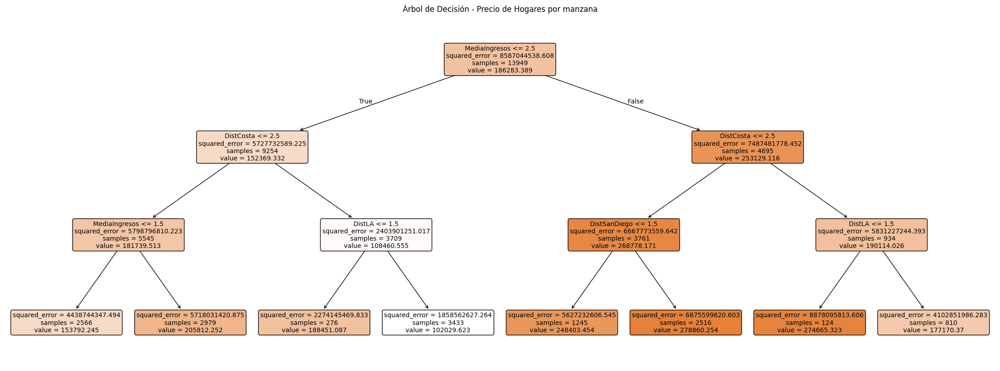

In [282]:
# Crear y entrenar árbol
tree_modelo = DecisionTreeRegressor(max_depth=3, random_state=42)  # Limitamos profundidad para visualización
tree_modelo.fit(X_train, y_train)

# Visualizar el árbol
plt.figure(figsize=(28, 10))
plot_tree(tree_modelo,
          feature_names=X.columns,
          filled=True,
          rounded=True,
          fontsize=10)
plt.title('Árbol de Decisión - Precio de Hogares por manzana')
plt.show()

In [283]:
from sklearn.tree import _tree

tree_modelo = DecisionTreeRegressor(max_depth=5, random_state=42)  # 5 atributos
tree_modelo.fit(X_train, y_train)
'''
def obtener_reglas_arbol(modelo, feature_names):
    tree_ = tree_modelo.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    reglas = []

    def recorrer_nodo(nodo, regla_actual):
        if tree_.feature[nodo] != _tree.TREE_UNDEFINED:
            # Nodo de decisión
            nombre = feature_name[nodo]
            umbral = tree_.threshold[nodo]

            # Rama izquierda (<=)
            regla_izq = regla_actual + [f"{nombre} <= {umbral:.2f}"]
            recorrer_nodo(tree_.children_left[nodo], regla_izq)

            # Rama derecha (>)
            regla_der = regla_actual + [f"{nombre} > {umbral:.2f}"]
            recorrer_nodo(tree_.children_right[nodo], regla_der)
        else:
            # Hoja - extraer valor de predicción
            valor = tree_.value[nodo][0][0]
            muestras = tree_.n_node_samples[nodo]
            reglas.append({
                'regla': ' Y '.join(regla_actual),
                'prediccion': valor,
                'muestras': muestras
            })

    recorrer_nodo(0, [])
    return reglas

# Usar la función
feature_names = X.columns.tolist()
reglas = obtener_reglas_arbol(tree_modelo, feature_names)

# Mostrar las reglas más importantes
for regla in sorted(reglas, key=lambda x: x['prediccion'], reverse=True)[:40]:
    print(f"Precio: ${regla['prediccion']:,.0f}")
    print(f"Muestras: {regla['muestras']}")
    print(f"Regla: {regla['regla']}")
    print("-" * 80)
'''

'\ndef obtener_reglas_arbol(modelo, feature_names):\n    tree_ = tree_modelo.tree_\n    feature_name = [\n        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"\n        for i in tree_.feature\n    ]\n\n    reglas = []\n\n    def recorrer_nodo(nodo, regla_actual):\n        if tree_.feature[nodo] != _tree.TREE_UNDEFINED:\n            # Nodo de decisión\n            nombre = feature_name[nodo]\n            umbral = tree_.threshold[nodo]\n\n            # Rama izquierda (<=)\n            regla_izq = regla_actual + [f"{nombre} <= {umbral:.2f}"]\n            recorrer_nodo(tree_.children_left[nodo], regla_izq)\n\n            # Rama derecha (>)\n            regla_der = regla_actual + [f"{nombre} > {umbral:.2f}"]\n            recorrer_nodo(tree_.children_right[nodo], regla_der)\n        else:\n            # Hoja - extraer valor de predicción\n            valor = tree_.value[nodo][0][0]\n            muestras = tree_.n_node_samples[nodo]\n            reglas.append({\n            

In [284]:
'''
# Mostrar las reglas más importantes
print("Reglas ordenadas por cantidad de muestras\n")
for regla in sorted(reglas, key=lambda x: x['muestras'], reverse=True)[:32]:
    print(f"Precio: ${regla['prediccion']:,.0f}")
    print(f"Muestras: {regla['muestras']}")
    print(f"Regla: {regla['regla']}")
    print("-" * 80)
'''

'\n# Mostrar las reglas más importantes\nprint("Reglas ordenadas por cantidad de muestras\n")\nfor regla in sorted(reglas, key=lambda x: x[\'muestras\'], reverse=True)[:32]:\n    print(f"Precio: ${regla[\'prediccion\']:,.0f}")\n    print(f"Muestras: {regla[\'muestras\']}")\n    print(f"Regla: {regla[\'regla\']}")\n    print("-" * 80)\n'

In [285]:

# Ejecuta esto para diagnosticar
def diagnostico_completo(modelo, X):
    tree = tree_modelo.tree_

    # Contar hojas
    n_hojas = 0
    for i in range(tree.node_count):
        if tree.children_left[i] == _tree.TREE_LEAF:
            n_hojas += 1

    print("=== DIAGNÓSTICO DEL ÁRBOL ===")
    print(f"Total de nodos: {tree.node_count}")
    print(f"Total de hojas: {n_hojas}")
    print(f"Muestras en raíz: {tree.n_node_samples[0]}")
    print(f"Muestras en dataset: {len(X)}")

    # Sumar muestras de todas las hojas
    total_muestras_hojas = 0
    for i in range(tree.node_count):
        if tree.children_left[i] == _tree.TREE_LEAF:
            total_muestras_hojas += tree.n_node_samples[i]

    print(f"Muestras en todas las hojas: {total_muestras_hojas}")
    print(f"Cobertura real: {total_muestras_hojas/len(X):.1%}")

diagnostico_completo(tree_modelo, X)

=== DIAGNÓSTICO DEL ÁRBOL ===
Total de nodos: 63
Total de hojas: 32
Muestras en raíz: 13949
Muestras en dataset: 17437
Muestras en todas las hojas: 13949
Cobertura real: 80.0%


In [292]:
def reglas_metricas_completas(modelo, X, y, feature_names, tolerancia=0.15, top_n=15):
    """
    Versión con todas las métricas: confianza, soporte y captura
    """
    tree_ = tree_modelo.tree_
    decisiones = tree_modelo.apply(X)
    total_dataset = len(X)      # 17,437
    total_arbol = tree_.n_node_samples[0]  # 13,949

    reglas = []

    def recorrer(nodo_id, regla_actual):
        if tree_.feature[nodo_id] != _tree.TREE_UNDEFINED:
            feature = feature_names[tree_.feature[nodo_id]]
            threshold = tree_.threshold[nodo_id]
            recorrer(tree_.children_left[nodo_id], regla_actual + [f"{feature} <= {threshold:.2f}"])
            recorrer(tree_.children_right[nodo_id], regla_actual + [f"{feature} > {threshold:.2f}"])
        else:
            indices_hoja = np.where(decisiones == nodo_id)[0]
            if len(indices_hoja) > 0:
                y_real = y.iloc[indices_hoja]
                y_pred = tree_.value[nodo_id][0][0]

                # Calcular métricas
                error_relativo = np.abs((y_real - y_pred) / y_real)
                confianza = np.sum(error_relativo <= tolerancia) / len(indices_hoja)
                soporte = len(indices_hoja) / total_dataset
                captura = len(indices_hoja) / total_arbol

                reglas.append({
                    'precio': y_pred,
                    'muestras': len(indices_hoja),
                    'confianza': confianza,
                    'soporte': soporte,
                    'captura': captura,
                    'regla': ' Y '.join(regla_actual)
                })

    recorrer(0, [])

    # Mostrar header
    print("=" * 100)
    print(f"{'PRECIO':<12} {'MUESTRAS':<10} {'CONFIANZA':<12} {'SOPORTE':<10} {'CAPTURA':<10} REGLA")
    print("=" * 100)

    # Mostrar reglas ordenadas por precio
    for i, r in enumerate(sorted(reglas, key=lambda x: x['confianza'], reverse=True)[:top_n]):
        print(f"${r['precio']:>9,.0f}  {r['muestras']:>8}   {r['confianza']:>9.1%}   {r['soporte']:>8.1%}  {r['captura']:>8.1%}   {r['regla']}")
feature_names = X.columns.tolist()
# Ejecutar
reglas_metricas_completas(tree_modelo, X, y, feature_names, tolerancia=0.25,  top_n=35)

PRECIO       MUESTRAS   CONFIANZA    SOPORTE    CAPTURA    REGLA
$  246,812         9      100.0%       0.1%      0.1%   MediaIngresos <= 2.50 Y DistCosta > 2.50 Y DistLA <= 1.50 Y Ambientes > 2.50 Y Poblacion <= 2.50
$  164,368        75       98.7%       0.4%      0.5%   MediaIngresos <= 2.50 Y DistCosta > 2.50 Y DistLA <= 1.50 Y Ambientes <= 2.50 Y Poblacion > 2.50
$  187,839       174       85.6%       1.0%      1.2%   MediaIngresos <= 2.50 Y DistCosta > 2.50 Y DistLA <= 1.50 Y Ambientes <= 2.50 Y Poblacion <= 2.50
$  184,389        12       83.3%       0.1%      0.1%   MediaIngresos > 2.50 Y DistCosta > 2.50 Y DistLA <= 1.50 Y MediaEdad <= 2.50 Y Dormitorios <= 1.50
$  202,624        78       82.1%       0.4%      0.6%   MediaIngresos <= 2.50 Y DistCosta > 2.50 Y DistLA <= 1.50 Y Ambientes > 2.50 Y Poblacion > 2.50
$  276,530       672       75.9%       3.9%      4.8%   MediaIngresos > 2.50 Y DistCosta <= 2.50 Y DistSanDiego > 1.50 Y DistCosta > 1.50 Y Ambientes > 2.50
$  262,159 

#Chequeo con RandomForest


IMPORTANCIA SEGÚN RANDOM FOREST:
MediaIngresos                  |  41.98%
DistCosta                      |  21.42%
DistLA                         |   7.67%
MediaEdad                      |   5.43%
Poblacion                      |   4.99%
Ambientes                      |   3.83%
Dormitorios                    |   3.36%
DistSanDiego                   |   3.31%
Familias                       |   2.75%
Cod_Region                     |   1.78%
DistSanJose                    |   1.78%
DistSanFran                    |   1.69%


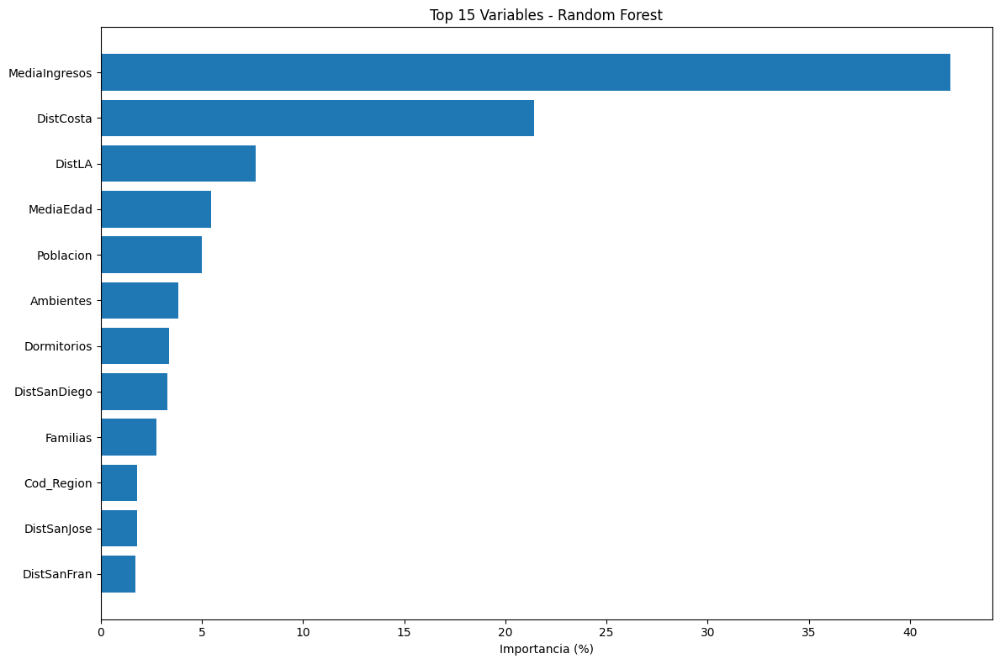

In [274]:
from sklearn.ensemble import RandomForestRegressor

# Modelo Random Forest
modelo_rf = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)  #n_jobs -1 usa todos los cores disponibles
                                                      #n_estimators 100 hace que sea relativamente rapido el procesamiento
modelo_rf.fit(X_train, y_train)

# Importancia de características
rf_importancia1 = pd.DataFrame({
    'Variable': X.columns,
    'Importancia': modelo_rf.feature_importances_
}).sort_values('Importancia', ascending=False)

print("\nIMPORTANCIA SEGÚN RANDOM FOREST:")
print("="*50)
for _, row in rf_importancia1.head(15).iterrows():
    print(f"{row['Variable']:30} | {row['Importancia']*100:6.2f}%")

# Visualizar top 15
plt.figure(figsize=(12, 8))
top_rf = rf_importancia1.head(15)
plt.barh(top_rf['Variable'], top_rf['Importancia']*100)
plt.xlabel('Importancia (%)')
plt.title('Top 15 Variables - Random Forest')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

In [275]:
r2s = r2_score(y_test, y_pred)
print(f"R2 Score: {r2s:.2f}")
print(f"Out-of-Bag Score: {regressor.oob_score_:.2f}")

R2 Score: 0.53
Out-of-Bag Score: 0.56


Distintos árboles de RandomForest

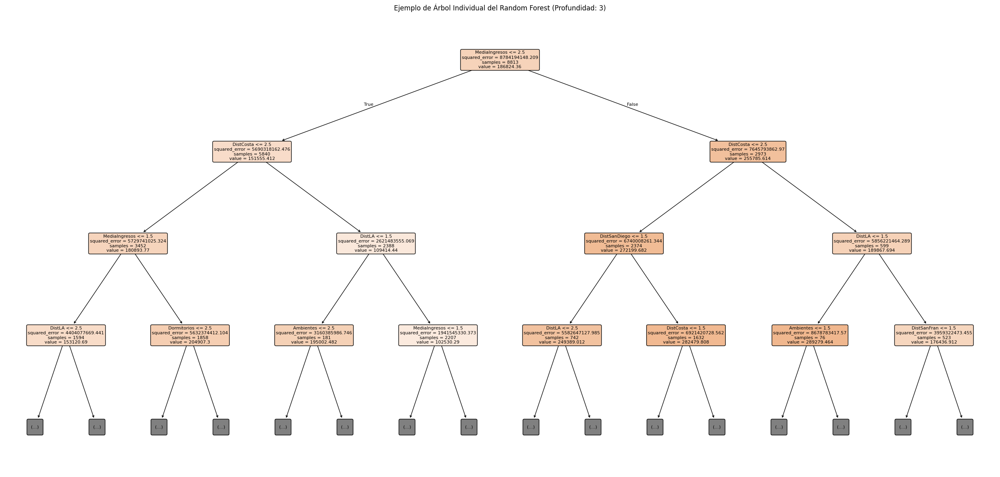

In [276]:
plt.figure(figsize=(25, 12))
plot_tree(modelo_rf.estimators_[0],  # Primer árbol del forest
          feature_names=X.columns,
          filled=True,
          rounded=True,
          max_depth=3,  # Limitamos profundidad para visualización
          fontsize=8)
plt.title('Ejemplo de Árbol Individual del Random Forest (Profundidad: 3)')
plt.tight_layout()
plt.show()

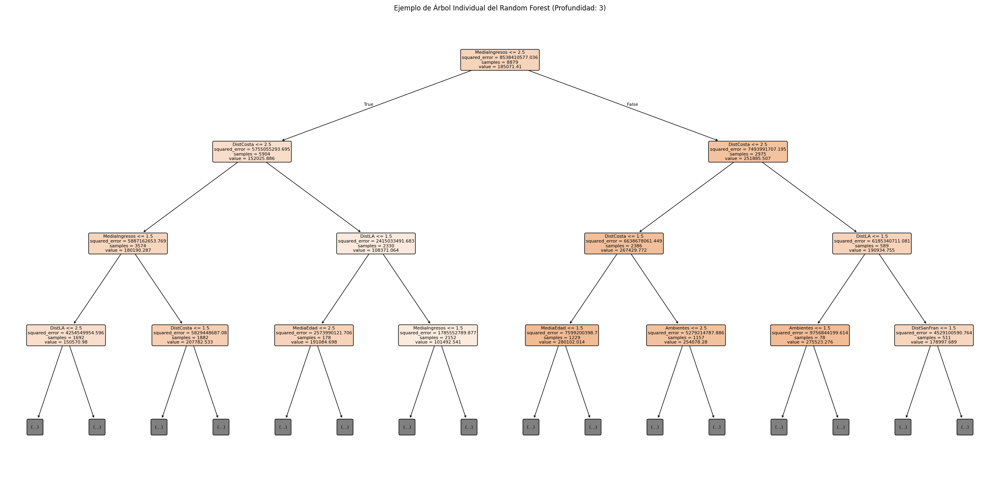

In [277]:
plt.figure(figsize=(25, 12))
plot_tree(modelo_rf.estimators_[2],  # Tercer árbol del forest
          feature_names=X.columns,
          filled=True,
          rounded=True,
          max_depth=3,  # Limitamos profundidad para visualización
          fontsize=8)
plt.title('Ejemplo de Árbol Individual del Random Forest (Profundidad: 3)')
plt.tight_layout()
plt.show()

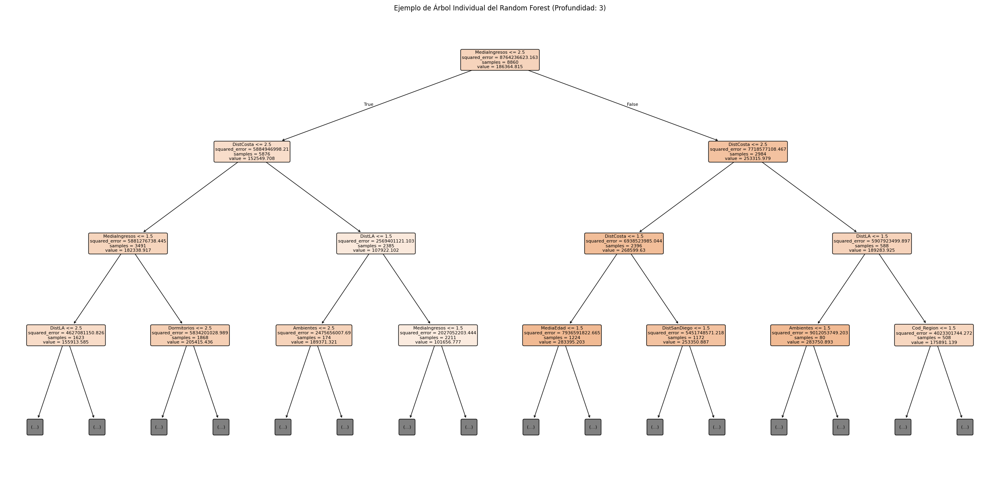

In [278]:
plt.figure(figsize=(25, 12))
plot_tree(modelo_rf.estimators_[9],  # Decimo árbol del forest
          feature_names=X.columns,
          filled=True,
          rounded=True,
          max_depth=3,  # Limitamos profundidad para visualización
          fontsize=8)
plt.title('Ejemplo de Árbol Individual del Random Forest (Profundidad: 3)')
plt.tight_layout()
plt.show()